In [307]:
#imports
import sys
import math
import cv2
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image

In [308]:
#variables
path_name = "/Users/slon/Downloads/17011211590000_74726debbb1c76e407a9bb0a5d329045.pdf - 2.png"

#variables for hough transformation
rho = 0.3 # distance resolution; default value is 1
theta = np.pi / 200 # angle resolution; default value is pi/180
hough_threshold = 250 # threshold value for identifying lines => only if number of intersections >threshold 
min_length = 100 # minimum length of a line
max_gap = 10 # maximum gap between lines

In [309]:
#display function
def display(im_path):
    dpi = 80
    im_data = plt.imread(im_path)

    height, width  = im_data.shape[:2]
    
    # What size does the figure need to be in inches to fit the image?
    figsize = width / float(dpi), height / float(dpi)

    # Create a figure of the right size with one axes that takes up the full figure
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0, 0, 1, 1])

    # Hide spines, ticks, etc.
    ax.axis('off')

    # Display the image.
    ax.imshow(im_data, cmap='gray')

    plt.show()


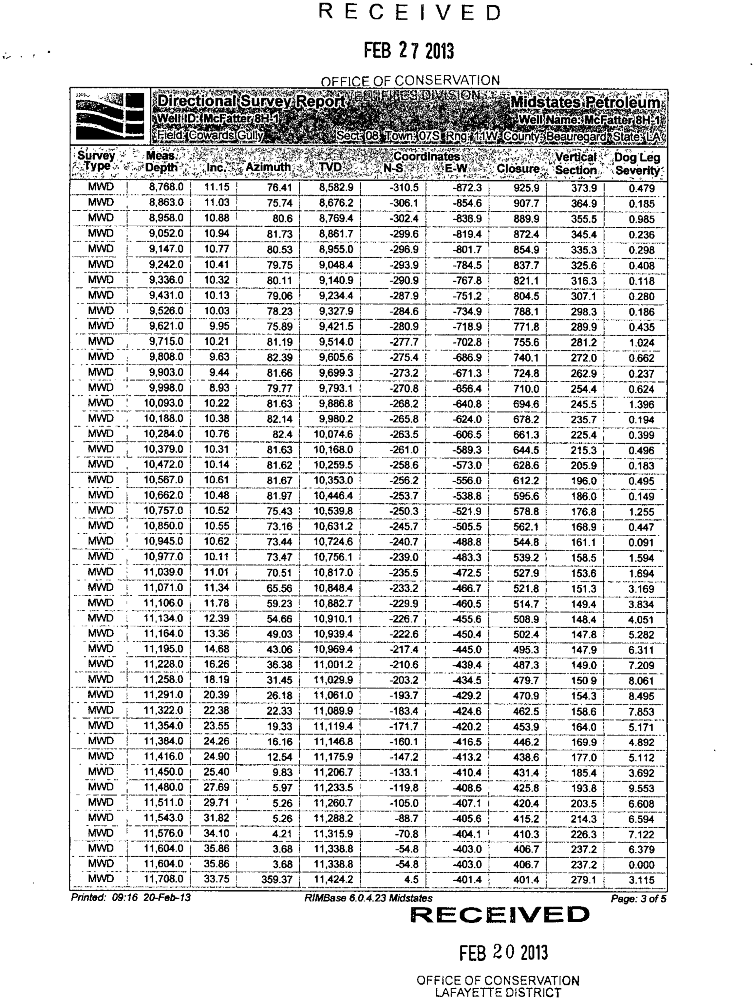

In [310]:
#open image
img = cv2.imread(path_name)
if len(img.shape) != 2:
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
else:
    gray = img
dst = cv2.Canny(img, 50, 200, None, 3)
display(path_name)

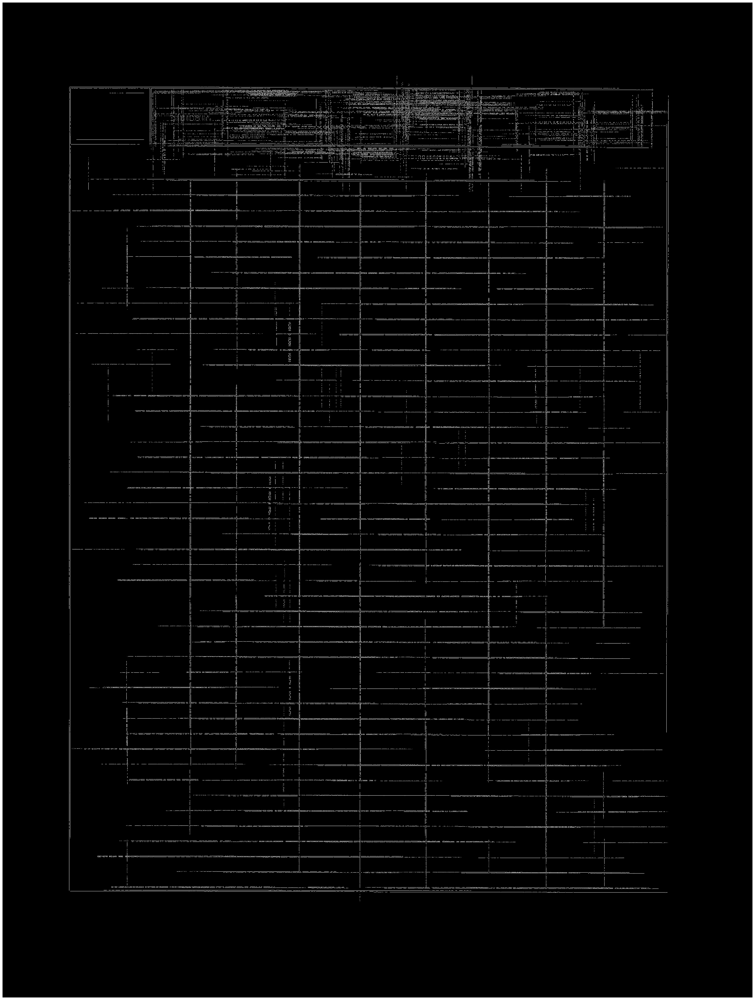

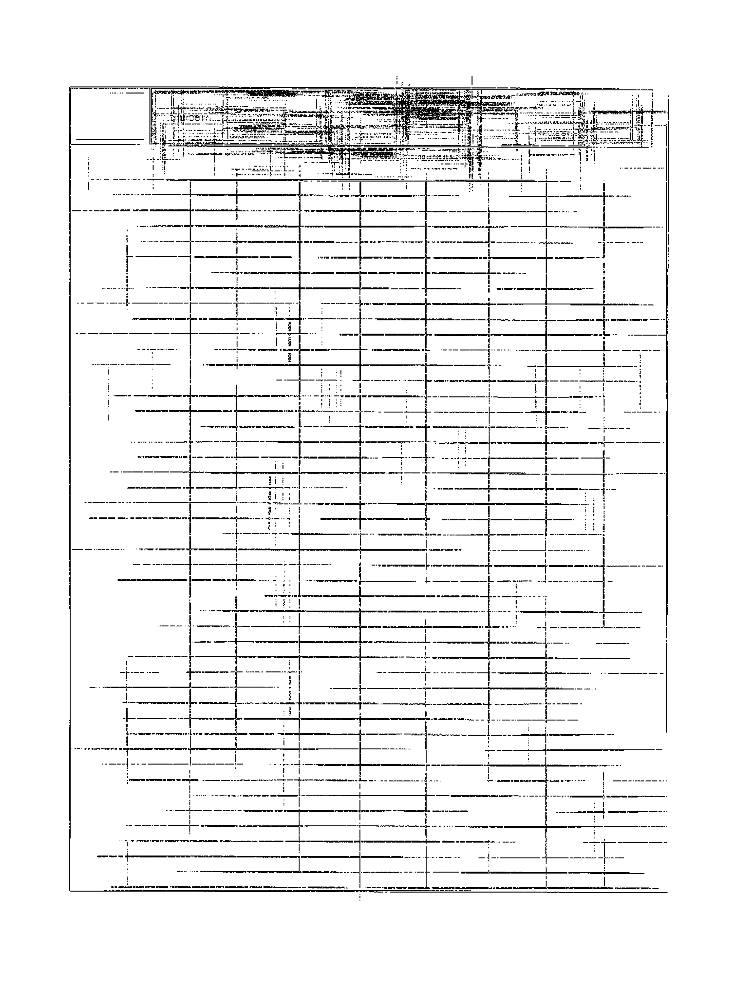

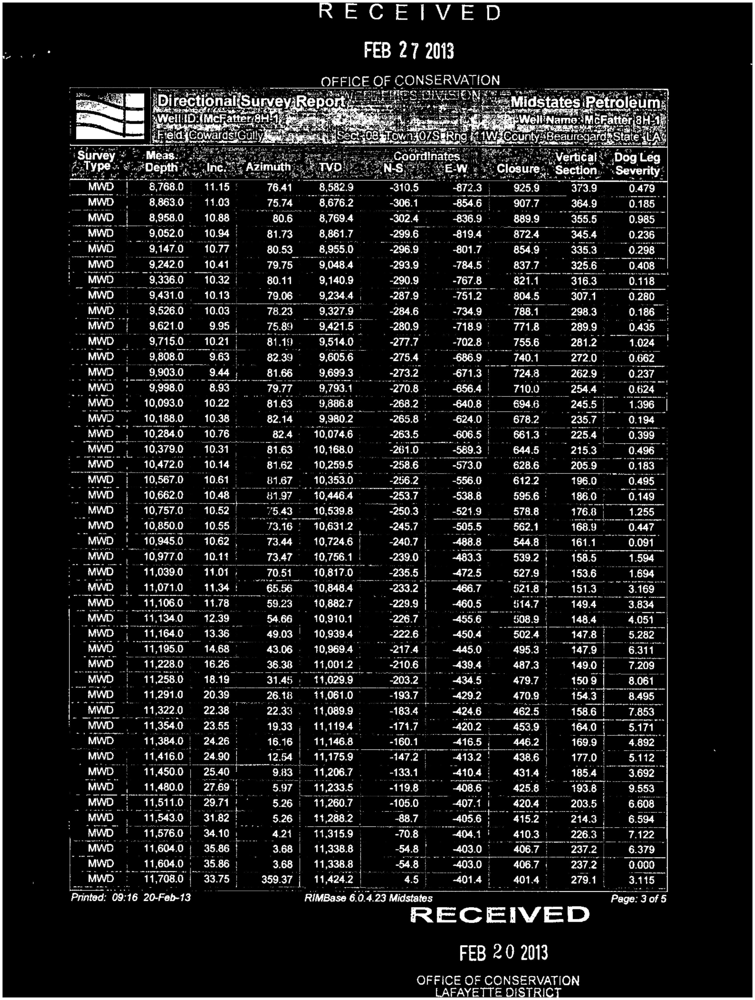

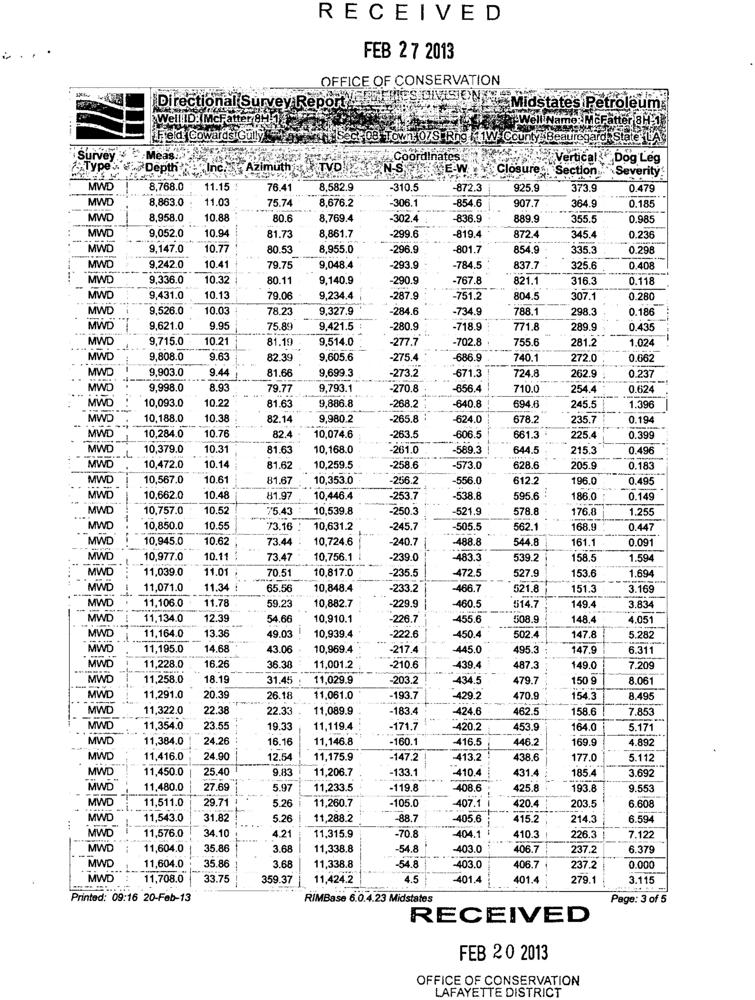

<class 'numpy.ndarray'>


In [311]:
gray = cv2.bitwise_not(gray)
bw = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, 
cv2.THRESH_BINARY, 15, -2)

linesP = cv2.HoughLinesP(dst, rho, theta, hough_threshold, None, min_length,max_gap)
cdst = cv.cvtColor(dst, cv.COLOR_GRAY2BGR)
cv2.imwrite("gray.png", cdst)

cdstP = np.copy(cdst)
if linesP is not None:
    for i in range(0, len(linesP)):
        l = linesP[i][0]
        cv2.line(cdstP, (l[0], l[1]), (l[2], l[3]), (0,0,0), 1, cv2.LINE_AA)


lines_extracted = cv2.bitwise_xor(cdstP, cdst)
cv2.imwrite("lines.png", lines_extracted)
display("lines.png")




lines_inv = cv2.bitwise_not(lines_extracted)
lines_inv = cv2.cvtColor(lines_inv, cv2.COLOR_BGR2GRAY)
blur = cv2.GaussianBlur(lines_inv,(3,3),0)
otsu_ret,otsu_threshold_image = cv2.threshold(blur,0 ,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
cv2.imwrite("inversed_lines.png", otsu_threshold_image)
display("inversed_lines.png")
# print(cdst.shape)
# print(gray.shape)
# print(lines_inv.shape)




masked_img = cv2.bitwise_and(gray, gray, mask=otsu_threshold_image)
cv2.imwrite("masked_img.jpg", masked_img)

display("masked_img.jpg")

final = cv2.bitwise_not(masked_img)

cv2.imwrite("final.jpg", final)

display("final.jpg")
print(type(dst))